# Mapping Exercise Visualising Data

This exercise allows the developer to generate an interactive map of Ireland, showing population variance over the 26 counties in the last 180 years.

In [2]:

# Run any of the install.packages() commands below for packages you don't have.
  #install.packages("tmap")
 # install.packages("leaflet")
  #install.packages("leaflet.extras")
  #install.packages("scales")
  #install.packages("htmlwidgets")
 #install.packages("sf")
  #install.packages("dplyr")
library(tidyverse)
library(raster)
library(RColorBrewer)
library(dplyr)
library("tmap")
library("scales")
library("leaflet")
library("sf")
library("leaflet.extras") #Needed for interactive map
library(htmlwidgets)
library(IRdisplay)



options(stringsAsFactors = FALSE)

── Attaching core tidyverse packages ──────────────────────────────────────────────────────────────── tidyverse 2.0.0 ──
✔ dplyr     1.1.4     ✔ readr     2.1.5
✔ forcats   1.0.0     ✔ stringr   1.5.1
✔ ggplot2   3.4.4     ✔ tibble    3.2.1
✔ lubridate 1.9.3     ✔ tidyr     1.3.1
✔ purrr     1.0.2     
── Conflicts ────────────────────────────────────────────────────────────────────────────────── tidyverse_conflicts() ──
✖ dplyr::filter() masks stats::filter()
✖ dplyr::lag()    masks stats::lag()
ℹ Use the conflicted package (<http://conflicted.r-lib.org/>) to force all conflicts to become errors
Loading required package: sp


Attaching package: 'raster'


The following object is masked from 'package:dplyr':

    select


Breaking News: tmap 3.x is retiring. Please test v4, e.g. with
remotes::install_github('r-tmap/tmap')


Attaching package: 'scales'


The following object is masked from 'package:purrr':

    discard


The following object is masked from 'package:readr':

    col_fact

## Step 1 Get and correct the shape files

 - Save irl_adm files in a sub-directory of your R directory
 - Save the location of it as IRshapefile
 - Using ogrListLayers, list the layers in the IRshapefile.
 - Check what's in each layer by reading the layer from IRshapefile using readOGR and generating a quick thematic map (qtm).  Also check the data in each layer.
 

In [3]:
# Load necessary libraries
library(tidyverse)
library(raster)
library(RColorBrewer)
library(dplyr)
library(tmap)
library(scales)
library(leaflet)
library(leaflet.extras) # Needed for interactive map
library(htmlwidgets)
library(IRdisplay)
library(sf)  # Load sf package for working with spatial data

# Set your working directory
setwd("C:/Users/markc/Desktop/DataVisuals/datasets")

# Save the location of the shapefile
IRshapefile <- "IRL_adm/IRL_adm1.shp"

# Read shapefile using sf
data_sf <- st_read(dsn = IRshapefile)

# List layers in the shapefile
names(data_sf)

# Read each layer and generate a thematic map
for (layer_name in names(data_sf)) {
  cat("Layer:", layer_name, "\n")
  layer_data <- data_sf[[layer_name]]
  print(layer_data)
  tm_shape(layer_data) +
    tm_borders() +
    tm_fill("lightblue", title = layer_name)
}


Reading layer `IRL_adm1' from data source 
  `C:\Users\markc\Desktop\DataVisuals\datasets\IRL_adm\IRL_adm1.shp' 
  using driver `ESRI Shapefile'
Simple feature collection with 26 features and 9 fields
Geometry type: MULTIPOLYGON
Dimension:     XY
Bounding box:  xmin: -10.66305 ymin: 51.41958 xmax: -5.993611 ymax: 55.45042
Geodetic CRS:  WGS 84


[1] "ID_0"      "ISO"       "NAME_0"    "ID_1"      "NAME_1"    "TYPE_1"   
 [7] "ENGTYPE_1" "NL_NAME_1" "VARNAME_1" "geometry"

Layer: ID_0 
 [1] 109 109 109 109 109 109 109 109 109 109 109 109 109 109 109 109 109 109 109
[20] 109 109 109 109 109 109 109
Layer: ISO 
 [1] "IRL" "IRL" "IRL" "IRL" "IRL" "IRL" "IRL" "IRL" "IRL" "IRL" "IRL" "IRL"
[13] "IRL" "IRL" "IRL" "IRL" "IRL" "IRL" "IRL" "IRL" "IRL" "IRL" "IRL" "IRL"
[25] "IRL" "IRL"
Layer: NAME_0 
 [1] "Ireland" "Ireland" "Ireland" "Ireland" "Ireland" "Ireland" "Ireland"
 [8] "Ireland" "Ireland" "Ireland" "Ireland" "Ireland" "Ireland" "Ireland"
[15] "Ireland" "Ireland" "Ireland" "Ireland" "Ireland" "Ireland" "Ireland"
[22] "Ireland" "Ireland" "Ireland" "Ireland" "Ireland"
Layer: ID_1 
 [1]  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25
[26] 26
Layer: NAME_1 
 [1] "Carlow"    "Cavan"     "Clare"     "Cork"      "Donegal"   "Dublin"   
 [7] "Galway"    "Kerry"     "Kildare"   "Kilkenny"  "Laoighis"  "Leitrim"  
[13] "Limerick"  "Longford"  "Louth"     "Mayo"      "Meath"     "Monaghan" 
[19] "Offaly"    "Roscommon" "Sligo"     "Tipper

MULTIPOLYGON (((-6.592422 52.7081, -6.592915 52...

MULTIPOLYGON (((-7.275174 53.78388, -7.275377 5...

MULTIPOLYGON (((-9.045278 52.71819, -9.045278 5...

MULTIPOLYGON (((-10.16361 51.57986, -10.16528 5...

MULTIPOLYGON (((-7.240834 55.44958, -7.240784 5...



In [4]:
# Define the path to your shapefile
IRshapefile <- "C:/Users/markc/Desktop/DataVisuals/datasets/IRL_adm/IRL_adm1.shp"

# Read in the layer with the counties and call it IRgeo
IRgeo <- st_read(dsn = IRshapefile)

# Rename the relevant column to 'County'
IRgeo <- rename(IRgeo, County = NAME_1)

# Add a Province name for each county
province_names <- c("Leinster", "Ulster", "Connacht", "Munster")  # Example province names
IRgeo$Province <- case_when(
  IRgeo$County %in% c("Carlow", "Dublin", "Kildare", "Kilkenny", "Laois", "Longford", "Louth", "Meath", "Offaly", "Westmeath", "Wexford", "Wicklow") ~ province_names[1],
  IRgeo$County %in% c("Cavan", "Donegal", "Monaghan") ~ province_names[2],
  IRgeo$County %in% c("Galway", "Leitrim", "Mayo", "Roscommon", "Sligo") ~ province_names[3],
  IRgeo$County %in% c("Clare", "Cork", "Kerry", "Limerick", "Tipperary", "Waterford") ~ province_names[4],
  TRUE ~ NA_character_
)

# Display the first few rows of the resulting data frame
head(IRgeo)


Reading layer `IRL_adm1' from data source 
  `C:\Users\markc\Desktop\DataVisuals\datasets\IRL_adm\IRL_adm1.shp' 
  using driver `ESRI Shapefile'
Simple feature collection with 26 features and 9 fields
Geometry type: MULTIPOLYGON
Dimension:     XY
Bounding box:  xmin: -10.66305 ymin: 51.41958 xmax: -5.993611 ymax: 55.45042
Geodetic CRS:  WGS 84


Registered S3 method overwritten by 'geojsonsf':
  method        from   
  print.geojson geojson



,ID_0,ISO,NAME_0,ID_1,County,TYPE_1,ENGTYPE_1,NL_NAME_1,VARNAME_1,geometry,Province
,<dbl>,<chr>,<chr>,<dbl>,<chr>,<chr>,<chr>,<chr>,<chr>,<MULTIPOLYGON [°]>,<chr>
1,109,IRL,Ireland,1,Carlow,Administrative County,County,NA,Ceatharlach,MULTIPOLYGON (((-6.592422 5...,Leinster
2,109,IRL,Ireland,2,Cavan,Administrative County,County,NA,An Cabhán,MULTIPOLYGON (((-7.275174 5...,Ulster
3,109,IRL,Ireland,3,Clare,Administrative County,County,NA,An Clár,MULTIPOLYGON (((-9.045278 5...,Munster
4,109,IRL,Ireland,4,Cork,Traditional County,County,NA,Corcaigh,MULTIPOLYGON (((-10.16361 5...,Munster
5,109,IRL,Ireland,5,Donegal,Administrative County,County,NA,Dún na nGall|Tyrconnel,MULTIPOLYGON (((-7.240834 5...,Ulster
6,109,IRL,Ireland,6,Dublin,Administrative County,County,NA,Baile Átha Cliath,MULTIPOLYGON (((-6.048584 5...,Leinster


 - Read in the layer with the counties in it and call it IRgeo. (Hint, the list of counties starts with  "Carlow" "Cavan" "Clare" "Cork")
 - Rename the relevant column to 'County'.
 - Run the code below to add a Province name for each county. 

## Step 2 - Enhance the data

 - Add the provinces to IRgeo using the code provided below
 - generate a qtm, labelling each county by name and colouring them by Province.

In [5]:
IRgeo@data$Province <- sapply(IRgeo@data$County, switch, 
                            
                            'Carlow' = 'Leinster',
                            'Cavan' = 'Ulster',
                            'Clare' = 'Munster',
                            'Cork' = 'Munster',
                            'Donegal' = 'Ulster',
                            'Dublin' = 'Leinster',
                            'Galway' = 'Connaught',
                            'Kerry' =  'Munster',
                            'Kildare' = 'Leinster',
                            'Kilkenny' = 'Leinster',
                            'Laoighis' = 'Leinster',
                            'Leitrim' = 'Connaught',
                            'Limerick' =  'Munster',
                            'Longford' = 'Leinster',
                            'Louth' = 'Leinster',
                            'Mayo' = 'Connaught',
                            'Meath' = 'Leinster',
                            'Monaghan' = 'Ulster',
                            'Offaly' = 'Leinster',
                            'Roscommon' = 'Connaught',
                            'Sligo' = 'Connaught',
                            'Tipperary' =  'Munster',
                            'Waterford' =  'Munster',
                            'Westmeath' = 'Leinster',
                            'Wexford' = 'Leinster',
                            'Wicklow' = 'Leinster')

ERROR: Error in IRgeo@data: no applicable method for `@` applied to an object of class "sf"


## Step 3 - generate a map.

Generate a map of irgeo, labelling each county with the English county names, colouring them by Province.

Warning message in st_point_on_surface.sfc(sf::st_zm(x)):
"st_point_on_surface may not give correct results for longitude/latitude data"


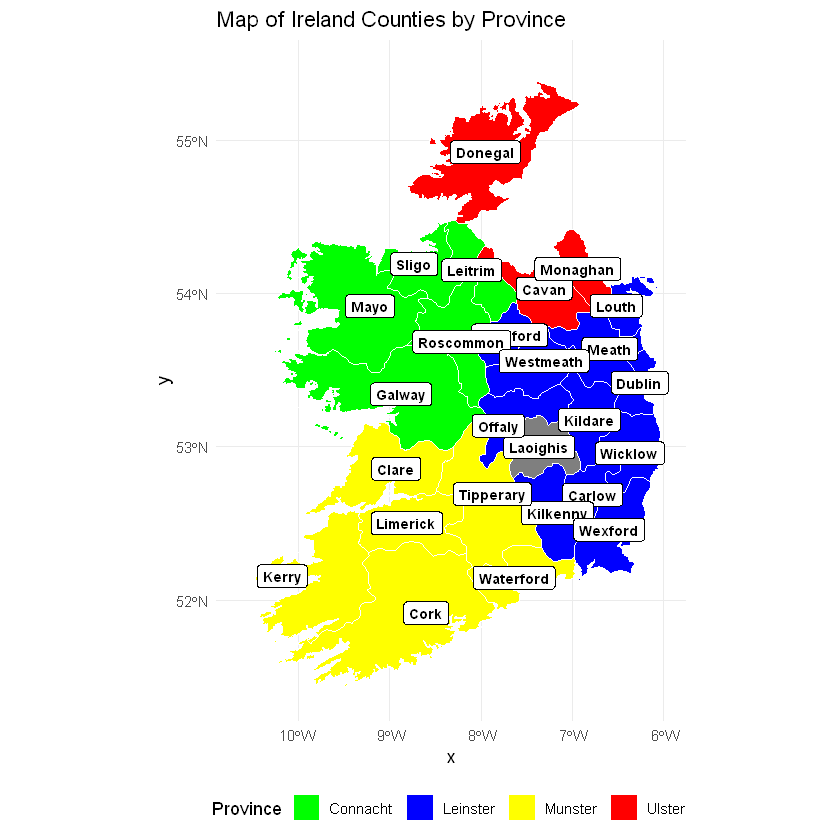

In [6]:
# Plot the map
ggplot() +
  geom_sf(data = IRgeo, aes(fill = Province), color = "white", size = 0.2) +
  geom_sf_label(data = IRgeo, aes(label = County), size = 3, color = "black", fontface = "bold") +
  scale_fill_manual(values = c("Leinster" = "blue", "Ulster" = "red", "Connacht" = "green", "Munster" = "yellow")) +
  theme_minimal() +
  labs(title = "Map of Ireland Counties by Province") +
  theme(legend.position = "bottom")

## Step 4 - Expand the data

 - Read in the population data into a data frame called popdata.  Rename the column 'county' to 'County'
 - As was done for 
 
 - Order IRgeo by County
 - Order popdata by County
 - Are they identical?  If not, where is the difference? Do you need to change any values in popdata? Hint: drop the rows that are in Northern Ireland (Antrim, Armagh, Derry, Down, Fermanagh and Tyrone) and check the spelling on anything else that doesn't match.
 
 - When they are identical, 
 - merge the population data with  IRgeo to give a new IRmap spatial polygon dataframe.


In [7]:
# Read in the population data
popdata <- read.csv("IRCountyPop.csv")  # Replace "population_data.csv" with the actual file name

# Rename the column 'county' to 'County'
colnames(popdata)[which(names(popdata) == "county")] <- "County"

# Order IRgeo by County
IRgeo <- IRgeo[order(IRgeo$County), ]

# Order popdata by County
popdata <- popdata[order(popdata$County), ]

# Check for differences between the two datasets
diff_counties <- setdiff(IRgeo$County, popdata$County)
diff_counties
# Check for spelling differences and drop rows for Northern Ireland counties
popdata <- popdata[!(popdata$County %in% c("Antrim", "Armagh", "Derry", "Down", "Fermanagh", "Tyrone")), ]

# Check if datasets are identical
identical(IRgeo$County, popdata$County)

# Merge population data with IRgeo to create IRmap
IRmap <- merge(IRgeo, popdata, by = "County")


character(0)

[1] TRUE

## Step 5

- Create a couple of static maps, showing the population in different years in each one. e.g. one for population in 1841 and one for population in 2001.
- Tidy up your map, add titles and shading and save it.

In [8]:


#Get the column names of popdata
col_names <- colnames(popdata)

#Remove "pop" from the column names
col_names_clean <- gsub("pop", "", col_names, ignore.case = TRUE)

#Assign the cleaned column names back to popdata
colnames(popdata) <- col_names_clean






Attaching package: 'gridExtra'


The following object is masked from 'package:dplyr':

    combine


Warning message in st_point_on_surface.sfc(sf::st_zm(x)):
"st_point_on_surface may not give correct results for longitude/latitude data"
Warning message in st_point_on_surface.sfc(sf::st_zm(x)):
"st_point_on_surface may not give correct results for longitude/latitude data"


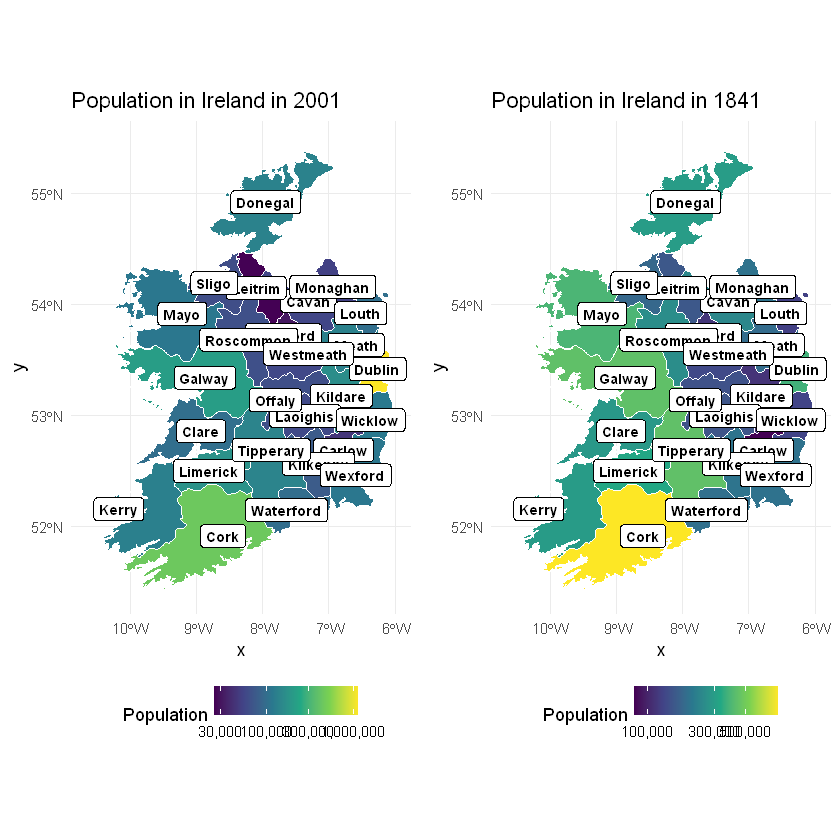

In [9]:
# Filter population data for 2001 and 1841
popdata_2001 <- popdata[, c("County", "2001")]
popdata_1841 <- popdata[, c("County", "1841")]

# Merge population data with IRgeo for 2001 and 1841
IRmap_2001 <- merge(IRgeo, popdata_2001, by = "County", all.x = TRUE)
IRmap_1841 <- merge(IRgeo, popdata_1841, by = "County", all.x = TRUE)

# Create maps for 2001 and 1841
map_2001 <- ggplot() +
  geom_sf(data = IRmap_2001, aes(fill = `2001`), color = "white", size = 0.2) +
  scale_fill_viridis_c(name = "Population", label = scales::comma, trans = "log10") +
  geom_sf_label(data = IRgeo, aes(label = County), size = 3, color = "black", fontface = "bold") +
  theme_minimal() +
  labs(title = "Population in Ireland in 2001", fill = "Population (log scale)") +
  theme(legend.position = "bottom")

map_1841 <- ggplot() +
  geom_sf(data = IRmap_1841, aes(fill = `1841`), color = "white", size = 0.2) +
  scale_fill_viridis_c(name = "Population", label = scales::comma, trans = "log10") +
  geom_sf_label(data = IRgeo, aes(label = County), size = 3, color = "black", fontface = "bold") +
  theme_minimal() +
  labs(title = "Population in Ireland in 1841", fill = "Population (log scale)") +
  theme(legend.position = "bottom")

# Plot the maps side by side
library(gridExtra)
grid.arrange(map_2001, map_1841, ncol = 2)


## Step 6 - static maps on merged data



## Step 7 - Create an interactive map using Open Street Map (Leaflet)

 - Decide which years you are going to use (up to 5 is more than enough)
 - Find a single minimum (minpop) and maximum population (maxpop) value over all the years you are mapping.
 - For each year, create a palette (example below)
    - Palette1841 <- colorQuantile(palette="Greens", domain =c(minpop, maxpop))
 - Create a popup showing the county name, and population for each of the years being mapped.
 - Transform your map to sf format.
 - Make a new object (e.g. IRmap2) using leaflet on IRmap.
 - Add provider tiles using CartoDB.  You can use Positron or DarkMatter.
 - Add a polygon for each layer, giving it the appropriate colour and group.
 - Add a legend at the bottom, giving colours of the different layers and their groups.

 - Instantiate the object
 - Save it as a HTML widget.

In [11]:
library(sf)
library(leaflet)

# Assuming you have already loaded and processed your data for the required years

# Determine the years to map
years <- c("1841", "1901", "2001")

# Find the minimum and maximum population values across all years
minpop <- min(unlist(lapply(popdata[, years], na.omit)))
maxpop <- max(unlist(lapply(popdata[, years], na.omit)))

# Create color palettes for each year
palette_list <- lapply(years, function(year) {
  colorQuantile(palette = "Greens", domain = c(minpop, maxpop))
})

# Create popups showing county name and population for each year
popup_list <- lapply(years, function(year) {
  popup <- paste("<b>County:</b>", popdata$County, "<br>",
                 "<b>Population (", year, "):</b>", popdata[[year]], "<br>")
})

# Transform map data to sf format
IRmap_sf <- st_as_sf(IRmap)

# Create Leaflet map object
IRmap_leaflet <- leaflet() %>%
  addProviderTiles("CartoDB.DarkMatter") %>%
  setView(lng = -7.9, lat = 53.4, zoom = 7) # Adjust coordinates and zoom level as needed

# Add polygons for each year with appropriate colors and groups
for (i in seq_along(years)) {
  year <- years[i]
  palette <- palette_list[[i]]
  popup <- popup_list[[i]]
  group_name <- paste("Year", year)  # Dynamically create a unique group name
  IRmap_leaflet <- IRmap_leaflet %>%
    addPolygons(data = IRmap_sf, fillColor = ~palette(popdata[[year]]), 
                fillOpacity = 0.8, color = "black", weight = 1,
                popup = popup, group = group_name) %>%
    addLayersControl(overlayGroups = group_name, 
                     options = layersControlOptions(collapsed = FALSE))
}

# Add legend
IRmap_leaflet <- IRmap_leaflet %>% 
  addLegend(pal = palette_list[[1]], values = popdata[[years[1]]], 
            title = "Population", opacity = 0.8, position = "bottomright")

# Instantiate the object
IRmap_leaflet


HTML widgets cannot be represented in plain text (need html)